In [1]:
from scene_change_detection.change_detector import SceneChangeDetector

/home/cmuser/ASIF/loco-simple/loco-env/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
import cv2
import os

def extract_frames(video_path, output_dir, fps=1):
    """
    Extract frames from a video at specified fps and save them to output directory.
    
    Args:
        video_path (str): Path to the input video file
        output_dir (str): Directory to save extracted frames
        fps (int): Desired frames per second to extract (default: 1)
    
    Returns:
        list: List of saved frame file paths
    """
    # Create output directory if it doesn't exist
    os.makedirs(output_dir, exist_ok=True)
    
    # Open the video file
    cap = cv2.VideoCapture(video_path)
    
    if not cap.isOpened():
        raise ValueError(f"Error: Could not open video file {video_path}")
    
    # Get video properties
    video_fps = cap.get(cv2.CAP_PROP_FPS)
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    
    # Calculate frame interval based on desired fps
    frame_interval = int(video_fps / fps)
    
    frame_paths = []
    frame_count = 0
    saved_count = 0
    
    while True:
        ret, frame = cap.read()
        if not ret:
            break
        
        # Save frame if it matches our interval
        if frame_count % frame_interval == 0:
            frame_filename = f"frame_{saved_count:06d}.jpg"
            frame_path = os.path.join(output_dir, frame_filename)
            cv2.imwrite(frame_path, frame)
            frame_paths.append(frame_path)
            saved_count += 1
        
        frame_count += 1
    
    cap.release()
    print(f"Extracted {saved_count} frames from {video_path} at {fps} fps")
    print(f"Frames saved to: {output_dir}")
    
    return frame_paths




In [3]:
video_path = "/home/cmuser/ASIF/loco-simple/videos/demo_data.mp4"
output_dir = "/home/cmuser/ASIF/loco-simple/outputs/demo_data_frames_1fps"

extract_frames(video_path, output_dir, 1)

Extracted 35 frames from /home/cmuser/ASIF/loco-simple/videos/demo_data.mp4 at 1 fps
Frames saved to: /home/cmuser/ASIF/loco-simple/outputs/demo_data_frames_1fps


['/home/cmuser/ASIF/loco-simple/outputs/demo_data_frames_1fps/frame_000000.jpg',
 '/home/cmuser/ASIF/loco-simple/outputs/demo_data_frames_1fps/frame_000001.jpg',
 '/home/cmuser/ASIF/loco-simple/outputs/demo_data_frames_1fps/frame_000002.jpg',
 '/home/cmuser/ASIF/loco-simple/outputs/demo_data_frames_1fps/frame_000003.jpg',
 '/home/cmuser/ASIF/loco-simple/outputs/demo_data_frames_1fps/frame_000004.jpg',
 '/home/cmuser/ASIF/loco-simple/outputs/demo_data_frames_1fps/frame_000005.jpg',
 '/home/cmuser/ASIF/loco-simple/outputs/demo_data_frames_1fps/frame_000006.jpg',
 '/home/cmuser/ASIF/loco-simple/outputs/demo_data_frames_1fps/frame_000007.jpg',
 '/home/cmuser/ASIF/loco-simple/outputs/demo_data_frames_1fps/frame_000008.jpg',
 '/home/cmuser/ASIF/loco-simple/outputs/demo_data_frames_1fps/frame_000009.jpg',
 '/home/cmuser/ASIF/loco-simple/outputs/demo_data_frames_1fps/frame_000010.jpg',
 '/home/cmuser/ASIF/loco-simple/outputs/demo_data_frames_1fps/frame_000011.jpg',
 '/home/cmuser/ASIF/loco-sim

In [4]:
change_detector = SceneChangeDetector(model_name="fastervit", similarity_threshold=0.9)

⚠️  FasterViT not available in timm, using alternative...


Unable to import quantization op. Please install modelopt library (https://github.com/NVIDIA/TensorRT-Model-Optimizer?tab=readme-ov-file#installation) to add support for compiling quantized models


✅ Model compiled with torch.compile
✅ TensorRT optimization available
✅ Scene Change Detector initialized with fastervit
📱 Device: cuda
⚡ FP16: True
🚀 TensorRT: True


In [5]:
from gpt_scene_description.gpt_descriptor import GPTSceneDescriptor

from dotenv import load_dotenv
load_dotenv()

import os


openai_api_key = os.getenv('OPENAI_API_KEY')

In [6]:
descriptor = GPTSceneDescriptor(model= "gpt-5-nano",api_key=openai_api_key)


✅ GPT Scene Descriptor initialized
🤖 Model: gpt-5-nano
🧠 Memory size: 10
🔗 Context enabled: True


In [7]:
def analyze_scene_changes(frames_dir, change_detector, descriptor):
    """
    Analyze all frames in a directory for scene changes and describe changed scenes.
    
    Args:
        frames_dir (str): Directory containing frame images
        change_detector: Scene change detector instance
        descriptor: Scene descriptor instance
    
    Returns:
        int: Number of scene changes detected
    """
    import os
    import cv2
    from PIL import Image
    import IPython.display
    
    # Get all frame files and sort them
    frame_files = [f for f in os.listdir(frames_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    frame_files.sort()
    
    if not frame_files:
        print("No image files found in the directory")
        return 0
    
    scene_change_count = 0
    
    print(f"Analyzing {len(frame_files)} frames for scene changes...")
    desc_memory = []
    
    for i, frame_file in enumerate(frame_files):
        frame_path = os.path.join(frames_dir, frame_file)
        
        # Load the frame
        image = cv2.imread(frame_path)
        if image is None:
            print(f"Could not load frame: {frame_file}")
            continue
        
        # Detect scene change
        status, processed_frame = change_detector.detect_scene_change(image)
        
        if status:
            scene_change_count += 1
            print(f"\n--- Scene Change #{scene_change_count} detected in frame: {frame_file} ---")
            
            # Convert frame for display
            display_frame = Image.fromarray(processed_frame)
            IPython.display.display(display_frame)
            
            # TODO: Get scene description
            # try:
            #     description = descriptor.describe_scene(processed_frame)
            #     desc_memory.append(description)
            #     print(f"Scene Description: {description}")
            # except Exception as e:
            #     print(f"Error describing scene: {e}")
            
            print("-" * 50)
    
    print(f"\nAnalysis complete!")
    print(f"Total scene changes detected: {scene_change_count}")
    print(f"Total frames analyzed: {len(frame_files)}")
    
    return scene_change_count


Analyzing 35 frames for scene changes...

--- Scene Change #1 detected in frame: frame_000004.jpg ---


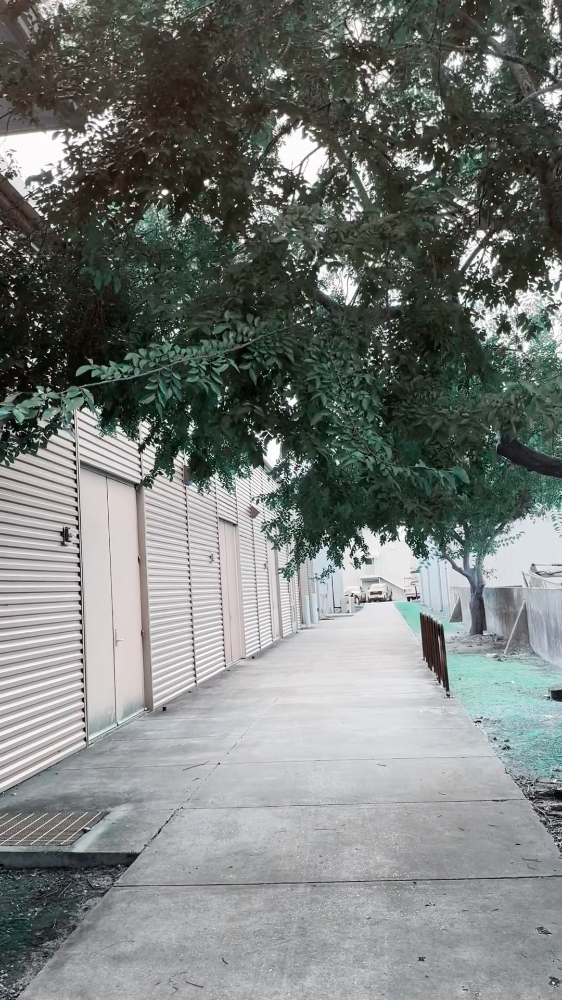

--------------------------------------------------

--- Scene Change #2 detected in frame: frame_000006.jpg ---


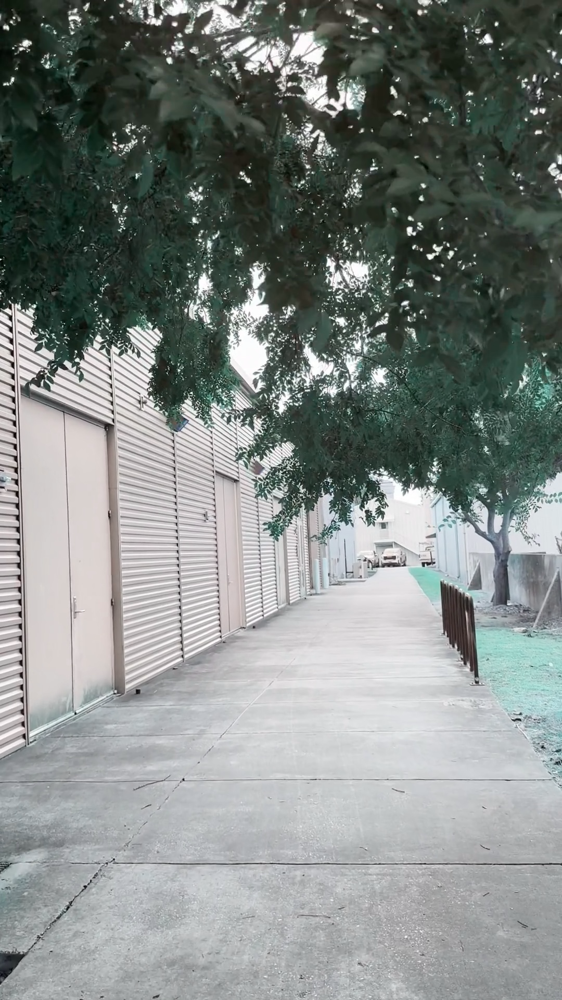

--------------------------------------------------

--- Scene Change #3 detected in frame: frame_000008.jpg ---


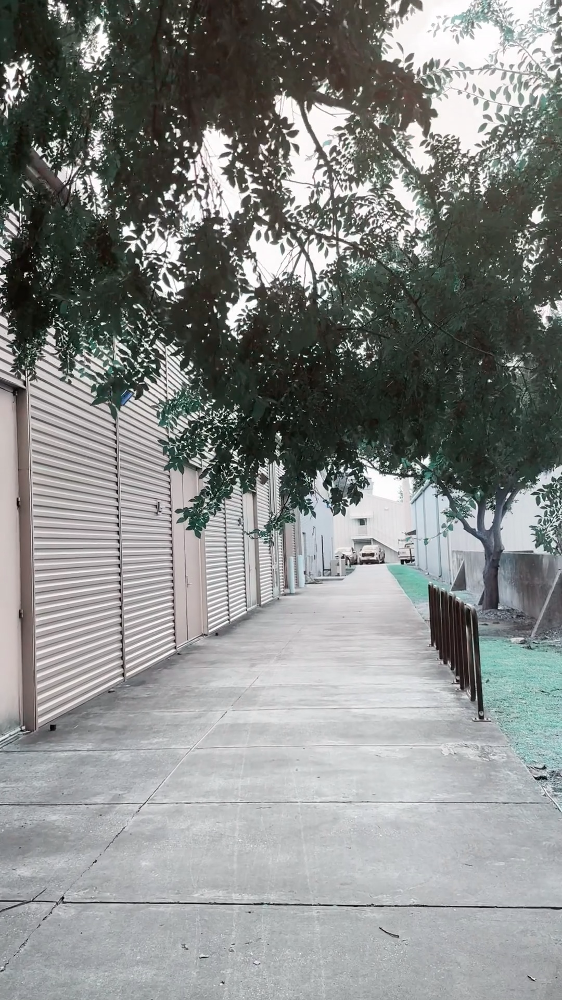

--------------------------------------------------

--- Scene Change #4 detected in frame: frame_000009.jpg ---


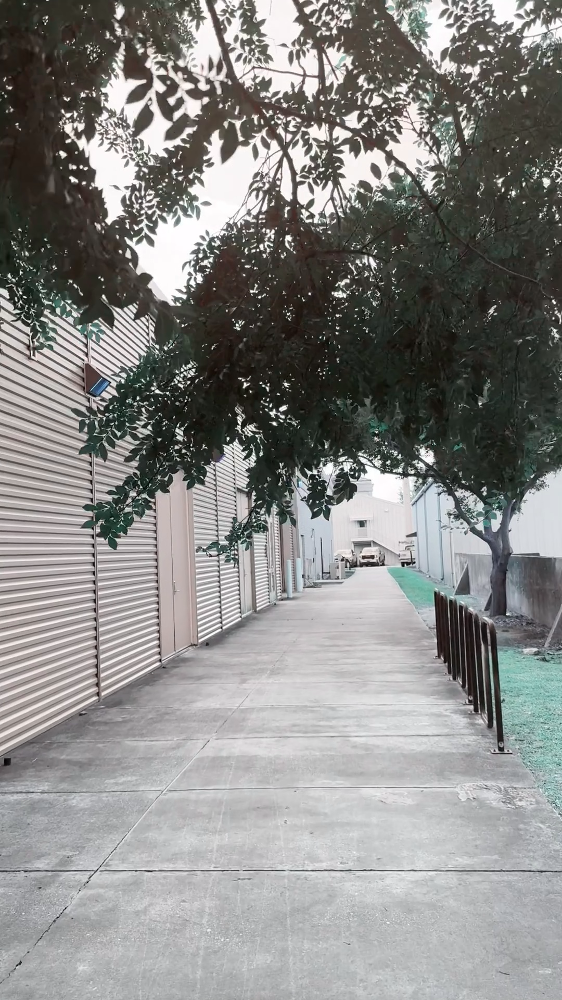

--------------------------------------------------

--- Scene Change #5 detected in frame: frame_000010.jpg ---


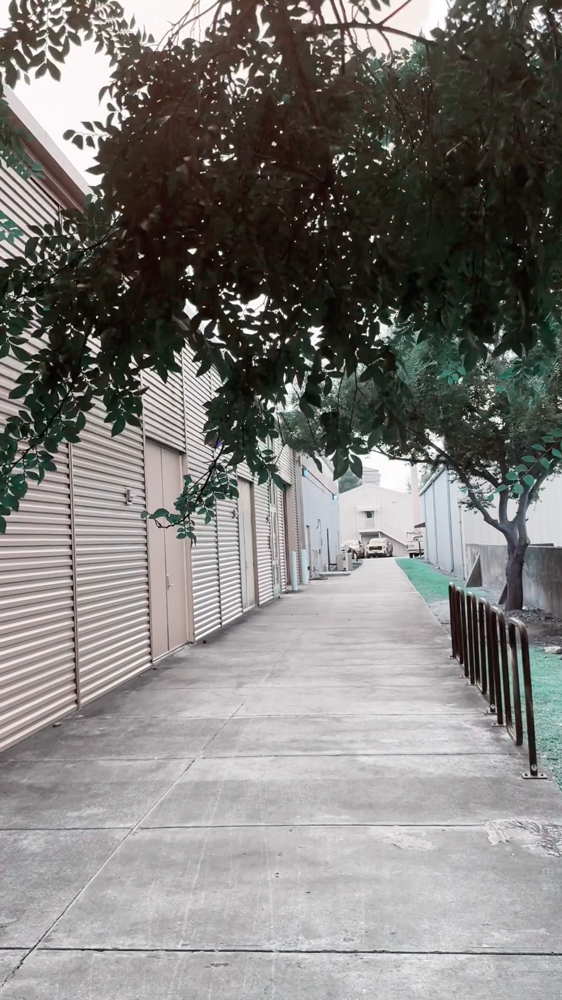

--------------------------------------------------

--- Scene Change #6 detected in frame: frame_000011.jpg ---


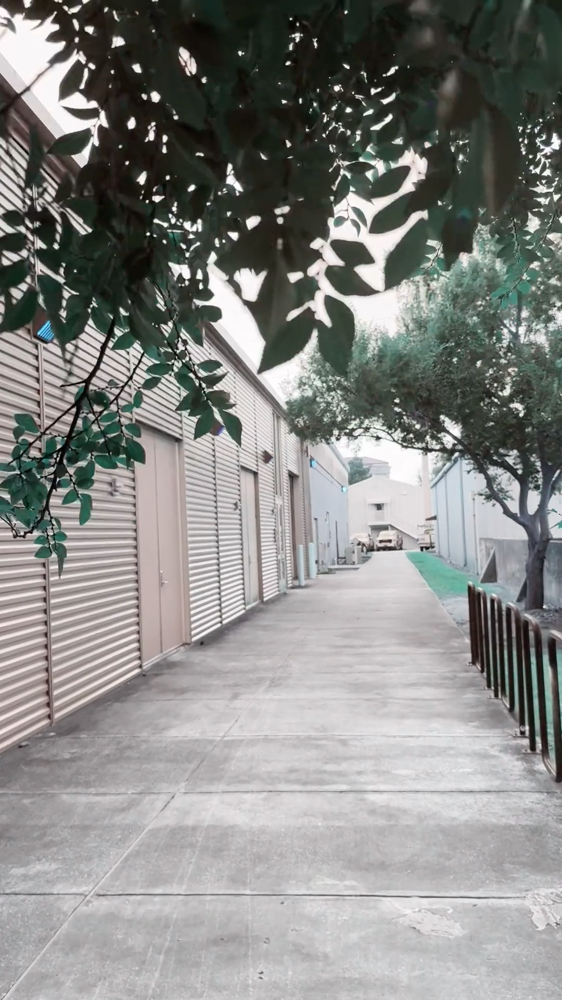

--------------------------------------------------

--- Scene Change #7 detected in frame: frame_000012.jpg ---


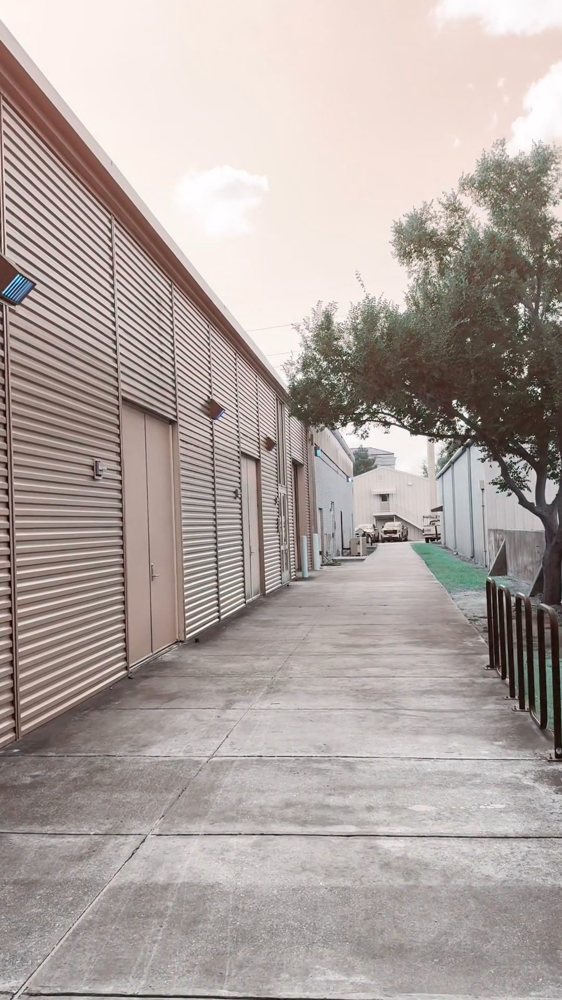

--------------------------------------------------

--- Scene Change #8 detected in frame: frame_000033.jpg ---


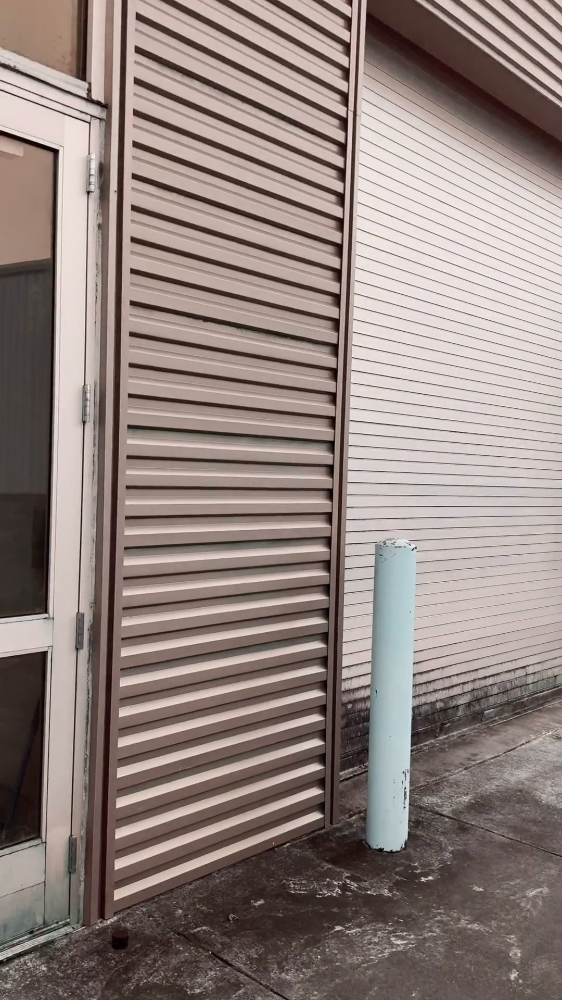

--------------------------------------------------

--- Scene Change #9 detected in frame: frame_000034.jpg ---


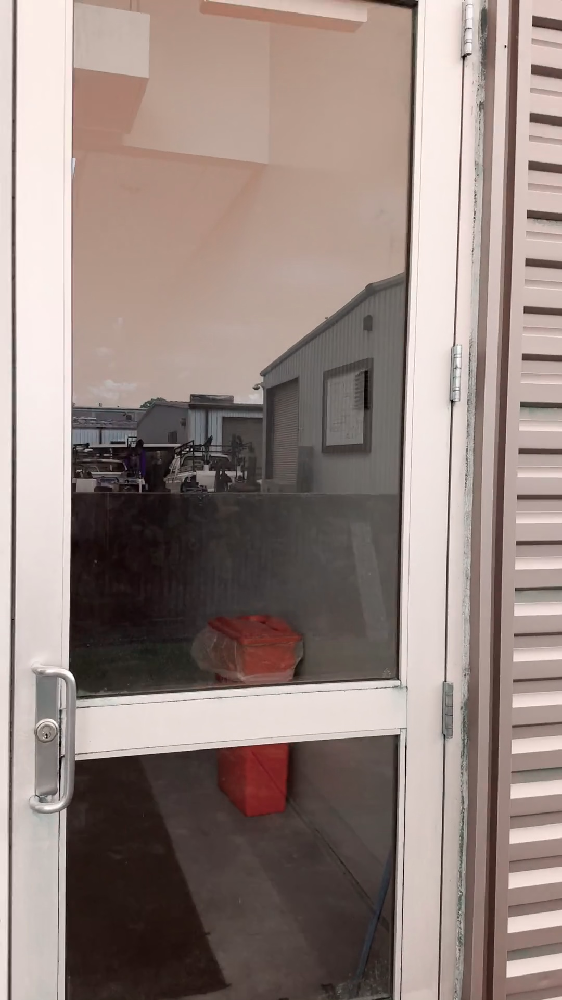

--------------------------------------------------

Analysis complete!
Total scene changes detected: 9
Total frames analyzed: 35


9

In [8]:
analyze_scene_changes(output_dir, change_detector, descriptor)

In [8]:
# load the image
import cv2
image_1 = cv2.imread("/home/cmuser/ASIF/loco-simple/outputs/demo_data_at_1fps_0c379378/frame_000960.jpg")

status, frame = change_detector.detect_scene_change(image_1)

Scene change detected


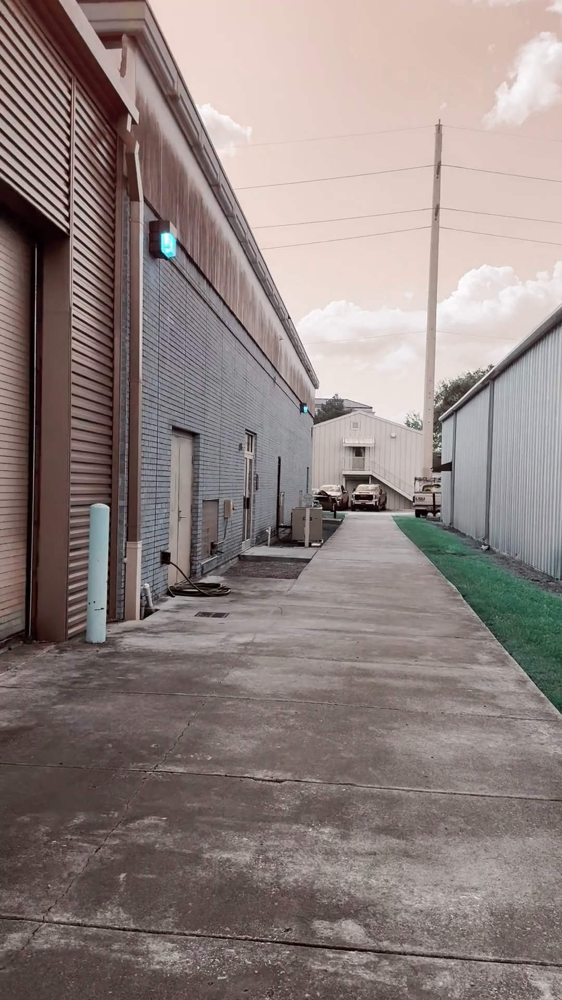

In [ ]:
import IPython
from PIL import Image
if status:
    print("Scene change detected")
    # convert the frame to a PIL image
    frame = Image.fromarray(frame)
    # use IPython to display the frame
    IPython.display.display(frame)
else:
    print("No scene change detected")
